In [58]:
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
from pandas import json_normalize
import psycopg2
from sklearn.model_selection import train_test_split,GridSearchCV
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
import joblib
from collections import Counter

In [59]:
# Labels
labels ={
  0: "Non-Performing Creative",   
  1: "Performing Creative"
}

In [60]:
# Fetching Data directly from Database
conn = psycopg2.connect(user = "ds_readonly", password = "blkbox2020!",host = "db.blkbox.ai",port = "5432",database = "blkbox")
sql = "select a.adaccount_id,a.date,a.entity_type,CAST(a.metadata as jsonb)->>'cpa' as cpa,CAST(a.metadata as jsonb)->>'cpi' as cpi,CAST(a.metadata as jsonb)->>'cpm' as cpm,CAST(a.metadata as jsonb)->>'ctr' as ctr,CAST(a.metadata as jsonb)->>'impressions' as impression,CAST(a.metadata as jsonb)->>'installs' as installs,CAST(a.metadata as jsonb)->>'spend' as spend,CAST(a.metadata as jsonb)->>'d7_roas' as d7_roas,(b.targets ->> 'd7_roas') as d7_roas1 from public.blkbox_performance_history a left join public.fb_app_adaccounts b on a.adaccount_id = b.adaccount_id where a.entity_type = 'CREATIVE' AND a.date >= date_trunc('month',current_date - interval '1' month) and a.date < date_trunc('month',current_date) order by a.date;"
data = pd.read_sql_query(sql, conn)
conn = None

In [61]:
data.head()

,adaccount_id,date,entity_type,cpa,cpi,cpm,ctr,impression,installs,spend,d7_roas,d7_roas1
0,act_3403297949786803,2021-05-01,CREATIVE,0,10.89,14.71,0.864164,3703,5,54,0,0.08
1,act_2991319124266485,2021-05-01,CREATIVE,0,1.71,5.75,0.84317,593,2,3,0,0.09
2,act_1929386790698216,2021-05-01,CREATIVE,0,1.13,2.26,0.686303,3497,7,8,0,0.15
3,act_1929386790698216,2021-05-01,CREATIVE,0,0,28.97,0,29,0,1,0,0.15
4,act_1929386790698216,2021-05-01,CREATIVE,0,1.41,1,0.10612,5654,4,6,0,0.15


In [62]:
data['target'] = np.where(data.d7_roas > data.d7_roas1, 1, 0)

data1 = data[['cpa','cpi','cpm','ctr','impression','installs','spend','target']].apply(pd.to_numeric)

data1['IPM'] = ((data1.installs * 1000) / data1.impression)

final = data1[['cpa','spend', 'cpi', 'cpm', 'ctr','IPM','target']]

In [63]:
final = final.dropna()
final.isnull().sum()

cpa       0
spend     0
cpi       0
cpm       0
ctr       0
IPM       0
target    0
dtype: int64

In [64]:
final.shape

(46468, 7)

In [65]:
final['target'].value_counts()

0    42883
1     3585
Name: target, dtype: int64

In [66]:
final[final.columns[1:-1]].apply(lambda x: x.corr(final['target']))

spend    0.173417
cpi      0.119871
cpm      0.002354
ctr     -0.015840
IPM      0.024883
dtype: float64

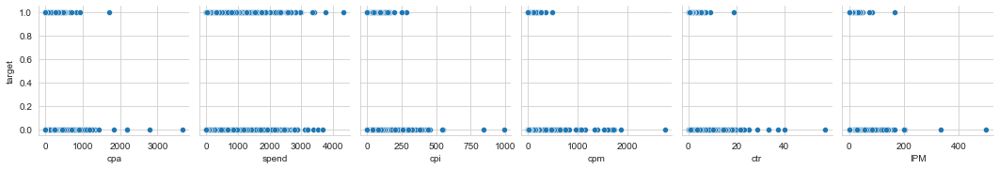

In [67]:
sns.pairplot(data=final,
                  x_vars=['cpa', 'spend', 'cpi', 'cpm', 'ctr', 'IPM'],
                  y_vars=['target'])

In [68]:
x = final.drop(['target'], axis=1)
y = final['target']

In [69]:
import statsmodels.api as sm
from scipy import stats

X2 = sm.add_constant(x)
est = sm.OLS(y, x)
est2 = est.fit()
print(est2.summary())

                                 OLS Regression Results                                
Dep. Variable:                 target   R-squared (uncentered):                   0.085
Model:                            OLS   Adj. R-squared (uncentered):              0.085
Method:                 Least Squares   F-statistic:                              722.3
Date:                Tue, 22 Jun 2021   Prob (F-statistic):                        0.00
Time:                        12:00:33   Log-Likelihood:                         -4337.7
No. Observations:               46468   AIC:                                      8687.
Df Residuals:                   46462   BIC:                                      8740.
Df Model:                           6                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [70]:
# import SMOTE module from imblearn library
sm = SMOTE(random_state = 2)
x, y = sm.fit_resample(x, y)

print(f"Training target statistics: {Counter(y)}")

Training target statistics: Counter({0: 42883, 1: 42883})


In [71]:
x_train,x_test,y_train,y_test = train_test_split(x,y, train_size= 0.75,stratify=y,random_state=42,shuffle=True)

print(f"Training target statistics: {Counter(y_train)}")
print(f"Testing target statistics: {Counter(y_test)}")

Training target statistics: Counter({0: 32162, 1: 32162})
Testing target statistics: Counter({0: 10721, 1: 10721})


In [72]:
# import SMOTE module from imblearn library
#sm = SMOTE(random_state = 2)
#x_train_res, y_train_res = sm.fit_resample(x_train, y_train)

#print(f"Training target statistics: {Counter(y_train_res)}")
#print(f"Testing target statistics: {Counter(y_test)}")

In [73]:
#from imblearn.over_sampling import RandomOverSampler
#over_sampler = RandomOverSampler(random_state = 42)
#x_res, y_res = over_sampler.fit(x_train, y_train)
#print(f"Training target statistics: {Counter(y_res)}")
#print(f"Testing target statistics: {Counter(y_test)}") 

In [74]:
rf_fit = RandomForestClassifier(n_estimators=100,criterion="gini",max_depth=None,min_samples_split=2,bootstrap=True,max_features='auto',random_state=42,min_samples_leaf=1)
rf_fit.fit(x_train, y_train.ravel())

RandomForestClassifier(random_state=42)

In [75]:
columns = list(final.columns)
columns

['cpa', 'spend', 'cpi', 'cpm', 'ctr', 'IPM', 'target']

Feature: cpa, Score: 0.07997
Feature: spend, Score: 0.20570
Feature: cpi, Score: 0.15720
Feature: cpm, Score: 0.23080
Feature: ctr, Score: 0.18792
Feature: IPM, Score: 0.13840


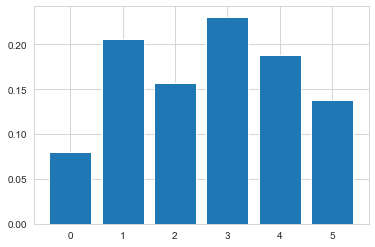

In [76]:
# get importance
importance = rf_fit.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
	print('Feature: %0s, Score: %.5f' % (columns[i],v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

In [77]:
# 10-Fold Cross validation
from sklearn.model_selection import cross_val_score
print('K-fold Cross Validation Score:',np.mean(cross_val_score(rf_fit, x_train, y_train, cv=10)))

K-fold Cross Validation Score: 0.886387513891757


In [78]:
from sklearn.metrics import accuracy_score,classification_report

print("\nRandom Forest - Train Confusion Matrix\n\n",pd.crosstab(y_train, rf_fit.predict(x_train),rownames=["Actuall"],colnames = ["Predicted"]))
print("\nRandom Forest - Train accuracy",round(accuracy_score(y_train,rf_fit.predict(x_train)),3))
print("\nRandom Forest - Train ClassificationReport\n",classification_report( y_train, rf_fit.predict(x_train)))

print("\n\nRandom Forest - Test Confusion Matrix\n\n",pd.crosstab(y_test, rf_fit.predict(x_test),rownames =["Actuall"],colnames = ["Predicted"]))
print("\nRandom Forest - Test accuracy",round(accuracy_score(y_test,rf_fit.predict(x_test)),3))
print("\nRandom Forest - Test Classification Report\n",classification_report( y_test, rf_fit.predict(x_test)))



Random Forest - Train Confusion Matrix

 Predicted      0      1
Actuall                
0          32159      3
1             20  32142

Random Forest - Train accuracy 1.0

Random Forest - Train ClassificationReport
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     32162
           1       1.00      1.00      1.00     32162

    accuracy                           1.00     64324
   macro avg       1.00      1.00      1.00     64324
weighted avg       1.00      1.00      1.00     64324



Random Forest - Test Confusion Matrix

 Predicted     0     1
Actuall              
0          9188  1533
1           771  9950

Random Forest - Test accuracy 0.893

Random Forest - Test Classification Report
               precision    recall  f1-score   support

           0       0.92      0.86      0.89     10721
           1       0.87      0.93      0.90     10721

    accuracy                           0.89     21442
   macro avg       0.89 

In [79]:
#export the model# Save the model as a pickle in a file
joblib.dump(rf_fit, 'test.pkl')
  
# Load the model from the file
model = joblib.load('test.pkl') 

In [80]:
# Use the loaded model to make predictions
x = [[52.976794, 53, 12.253068, 9.476699, 0.542769, 0.780223]]
predict = model.predict(x)
print("Your Predictions:")
print(labels[predict[0]])

Your Predictions:
Performing Creative
